# Task

The goal of the task is to understand your strengths in the data science process. The home task consists of a problem that is similar to our day-to-day work. We will share a synthetic dataset with you and a task description, and we expect you to submit a rendered notebook showing your work. 

 

We will evaluate:

The quality of your exploratory data analysis
The coherence and structure of your ideas and code
Your modeling approach, training, and validation methodology
The applicability of your modeling technique to the real-life task you are trying to solve
Your take on how the impact of the model should be evaluated in real-world interactions with our user base 
Please find the introduction to the task here:

 

Efficient supply allocation

The success of Bolt as a ride-hailing platform depends on a marketplace or efficient matching supply and demand in real-time. There are two sides in a ride-hailing marketplace: riders (demand) and drivers (supply). One of the challenges that we aim to solve is efficient supply allocation, so riders can always get a ride and drivers have stable earnings. Knowledge about how demand changes over time and space is crucial to comprehend supply dynamics. 

 
 The source data is approximately 630000 rows of synthetic ride demand data which resembles the real-life situation in the city of Tallinn:

    start_time - time when the order was made
    start_lat - latitude of the order's pick-up point
    start_lng - longitude of the order's pick-up point
    end_lat - latitude of the order's destination point
    end_lng - longitude of the order's destination point
    ride_value - how much monetary value is in this particular ride


For this test task we expect you to:

* Explore the data and suggest a solution to guide the drivers towards areas with higher expected demand at given time and location
* Build and document a baseline model for your solution
* Describe how you would design and deploy such a model
* Describe how to communicate model recommendations to drivers
* Think through and describe the design of the experiment  that would validate your solution for live operations taking into account marketplace specifics

The goal of the task is to understand your strengths in the data science fundamentals and product thinking.

Data for the task:
The source data is approximately 630000 rows of synthetic ride demand data which resembles the real-life situation in the city of Tallinn:

start_time - time when the order was made
start_lat - latitude of the order's pick-up point
start_lng - longitude of the order's pick-up point
end_lat - latitude of the order's destination point
end_lng - longitude of the order's destination point
ride_value - how much monetary value is in this particular ride
Please do not spend more than 8 hours on this task.

Please describe what additional data would you consider useful and cite the main references used in your solution, if any.
Solve the task in Python and present it in a rendered Jupyter notebook exported as html, please upload it on the link as zip file.

# Introduction 

1. Exploration
- importing library
- loading data
- EDA
- data cleaning
- visualisation of columns
- lat long plots
- key start locations

2. Feature Engineering
- total displacment
- day , hour, month
- district
- time of the day
- time of the day vs total displacement

3. Clustering analysis
- by ride value (k means)
- by displacement (didnt give good results)

4. Predictive Modelling 

a. by district and subdistict data
- data creation 
- racing bar graph for district vs day
training arima , random forest , linear regression , ridge lasso regression model
- exporting model

b. by density based clustering
- creating data
- DBSCAN
- training model on cluster data 
- exporting model

other analysis

answering questions 

# ********* Part 1 : Exploration ***********

# importing library

In [10]:
import folium
import geopandas as gpd
from shapely.geometry import Point
from folium.plugins import HeatMapWithTime
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
# Re-importing necessary libraries after execution state reset
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tools.eval_measures import rmse
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import LabelEncoder
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.linear_model import Lasso, Ridge
from sklearn.linear_model import LinearRegression
import xgboost as xgb
from sklearn.metrics import mean_absolute_error
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import silhouette_score
import joblib
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import warnings
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline


from geopy.distance import geodesic
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from sklearn.model_selection import cross_val_score
import matplotlib.animation as animation
from IPython.display import HTML

In [11]:


warnings.filterwarnings('ignore')


custom_colors = ['#0e1a50', '#067a72', '#c8eae8', '#eb0046', '#ffae80', '#0050ff', '#bad8fc']
cpalette = sns.color_palette(custom_colors)


# loading data 

In [12]:
data =pd.read_csv('data.csv')
data.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value
0,2022-03-06 15:02:39.329452000,59.407910,24.689836,59.513027,24.831630,3.51825
1,2022-03-10 11:15:55.177526000,59.441650,24.762712,59.426450,24.783076,0.50750
2,2022-03-06 14:23:33.893257000,59.435404,24.749795,59.431901,24.761588,0.19025
3,2022-03-03 09:11:59.104192000,59.406920,24.659006,59.381093,24.641652,0.75600
4,2022-03-06 00:13:01.290346000,59.434940,24.753641,59.489203,24.876170,2.27100


# Exploratory Data Analysis (EDA)

In [13]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
start_lat,627210.0,59.428682,0.021764,59.321557,59.418803,59.432069,59.439024,59.566998
start_lng,627210.0,24.743468,0.056872,24.505199,24.713140,24.744674,24.768115,24.973743
end_lat,627210.0,59.397797,1.392755,-37.819979,59.415215,59.430697,59.439262,61.552744
end_lng,627210.0,24.724847,1.650709,-122.453962,24.707919,24.744335,24.773924,144.966110
ride_value,627210.0,2.261384,44.889892,0.107628,0.545250,1.059000,1.712000,3172.701000


In [14]:
data.start_time.min(),data.start_time.max()
# data is for march 2022 only

('2022-03-01 00:00:07.936317000', '2022-03-28 23:59:53.175658000')

# data cleaning

In [15]:
# missing values
data.isnull().sum().sum()

0

In [16]:
#duplicate values
print ('duplicate values',data.duplicated().sum())
# removing duplicate rows
data = data.drop_duplicates()

duplicate values 4564


In [17]:

# Rides <= 15
rides_le_15_sum = data['ride_value'].sum()
rides_le_15_count = data.shape[0]

# Rides > 15
rides_gt_15 = data[data['ride_value'] > 15]
rides_gt_15_sum = rides_gt_15['ride_value'].sum()
rides_gt_15_count = rides_gt_15.shape[0]

rides_le_15_sum, rides_le_15_count, rides_gt_15_sum, rides_gt_15_count

summary_table = pd.DataFrame({
    "Ride Value Category": ["≤ 15", "> 15"],
    "Sum of Ride Values": [round(rides_le_15_sum, 2), round(rides_gt_15_sum, 2)],
    "Ride Counts": [rides_le_15_count, rides_gt_15_count]
})

summary_table


,Ride Value Category,Sum of Ride Values,Ride Counts
0,≤ 15,1412532.59,622646
1,> 15,635103.80,683


##  almost 30% of revenue is generated from 683 rides 

# plotting columns 

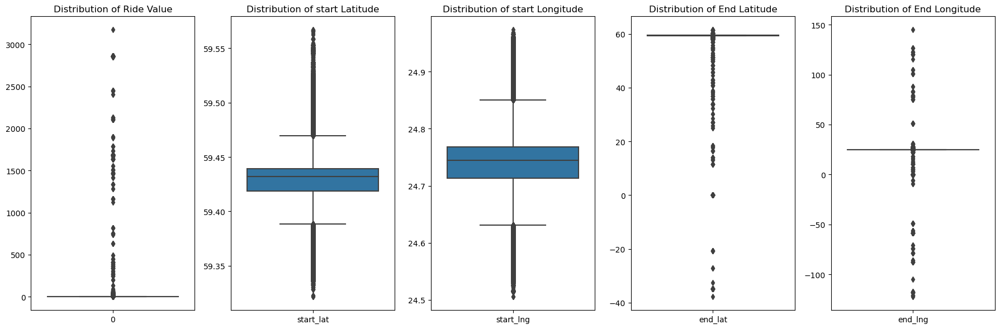

In [18]:

# Setting up the figure size and subplots
plt.figure(figsize=(18, 6))

# Distribution of `ride_value`
plt.subplot(1, 5, 1)
sns.boxplot(data=data['ride_value'])
plt.title('Distribution of Ride Value')

# Distribution of `start_lat`
plt.subplot(1, 5, 2)
sns.boxplot(data=data[['start_lat']])
plt.title('Distribution of start Latitude')

# Distribution of `start_lng`
plt.subplot(1, 5, 3)
sns.boxplot(data=data[['start_lng']])
plt.title('Distribution of start Longitude')

# Distribution of `end_lat`
plt.subplot(1, 5, 4)
sns.boxplot(data=data[['end_lat']])
plt.title('Distribution of End Latitude')

# Distribution of `end_lng`
plt.subplot(1, 5, 5)
sns.boxplot(data=data[['end_lng']])
plt.title('Distribution of End Longitude')

plt.tight_layout()
plt.show()

# Feature Engineering
1. calculating displacement from start lat long to end lat long
2. getting the district name based on the start lat long
3. time of the day of the ride
4. splitting start time into day month week


In [19]:
from geopy.distance import geodesic
from geopy.geocoders import Nominatim

# Defining a function to calculate displacement between start and end coordinates
def calculate_displacement(row):
    start_point = (row['start_lat'], row['start_lng'])
    end_point = (row['end_lat'], row['end_lng'])
    # Calculating the distance using geodesic distance (in kilometers)
    distance = geodesic(start_point, end_point).kilometers
    return distance

# Applying the function to each row in the DataFrame
data['displacement_km'] = data.apply(calculate_displacement, axis=1)
data.head()



# Initialize the geolocator
geolocator = Nominatim(user_agent="geoapiExercises")

def get_district(lat, long):
    try:
        # Perform reverse geocoding to get the location details
        location = geolocator.reverse((lat, long), exactly_one=True, language='en')
        address = location.raw['address']
        
        # Extract the district or relevant location component
        district = address.get('suburb', None) or address.get('city_district', None) or address.get('county', None)
        return district
    except:
        # In case of any error, return None or a default value
        return None

# since above function will require too many api calls we will move to simplier approx solution
def get_district_name(lat, lon):
    # Define bounding boxes for each district
    districts = {
        'Haabersti': ((59.398, 24.635), (59.436, 24.718)),
        'City Centre': ((59.422, 24.713), (59.453, 24.777)),
        'Kristiine': ((59.411, 24.666), (59.437, 24.730)),
        'Lasnamäe': ((59.411, 24.790), (59.470, 24.889)),
        'Mustamäe': ((59.383, 24.641), (59.424, 24.716)),
        'Nõmme': ((59.357, 24.595), (59.403, 24.731)),
        'Pirita': ((59.436, 24.772), (59.501, 24.912)),
        'North Tallinn': ((59.429, 24.665), (59.458, 24.754)),
    }
    
    for district, ((sw_lat, sw_lon), (ne_lat, ne_lon)) in districts.items():
        if sw_lat <= lat <= ne_lat and sw_lon <= lon <= ne_lon:
            return district
    
    return "Unknown"

data['district'] = data.apply(lambda row: get_district_name(row['start_lat'], row['start_lng']), axis=1)
data['End_district'] = data.apply(lambda row: get_district_name(row['end_lat'], row['end_lng']), axis=1)
data.head()


def categorize_time(hour): 
    if 5 <= hour < 12:return 'Morning'
    elif 12 <= hour < 17 : return 'Afternoon'
    elif 17 <= hour < 21: return 'Evening'
    else: return 'Night'




# Extract  date,  hour,  day oy ueeh,  and month  froms tant_time
data['start_time']=pd.to_datetime(data['start_time'])
data['date'] = data['start_time'].dt.date
data['hour'] = data['start_time'].dt.hour
data['day_of_week'] = data['start_time'].dt.dayofweek # Mondoy=0, Sundoy=
data['month'] = data['start_time'].dt.month
data['time_of_day']=data['hour'].apply(categorize_time)


data.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,displacement_km,district,End_district,date,hour,day_of_week,month,time_of_day
0,2022-03-06 15:02:39.329452,59.407910,24.689836,59.513027,24.831630,3.51825,14.205080,Haabersti,Unknown,2022-03-06,15,6,3,Afternoon
1,2022-03-10 11:15:55.177526,59.441650,24.762712,59.426450,24.783076,0.50750,2.050095,City Centre,Unknown,2022-03-10,11,3,3,Morning
2,2022-03-06 14:23:33.893257,59.435404,24.749795,59.431901,24.761588,0.19025,0.774715,City Centre,City Centre,2022-03-06,14,6,3,Afternoon
3,2022-03-03 09:11:59.104192,59.406920,24.659006,59.381093,24.641652,0.75600,3.041401,Haabersti,Nõmme,2022-03-03,9,3,3,Morning
4,2022-03-06 00:13:01.290346,59.434940,24.753641,59.489203,24.876170,2.27100,9.209442,City Centre,Pirita,2022-03-06,0,6,3,Night


# column analysis


* this shows number of days of each week day is different so we should use avg analysis not sum

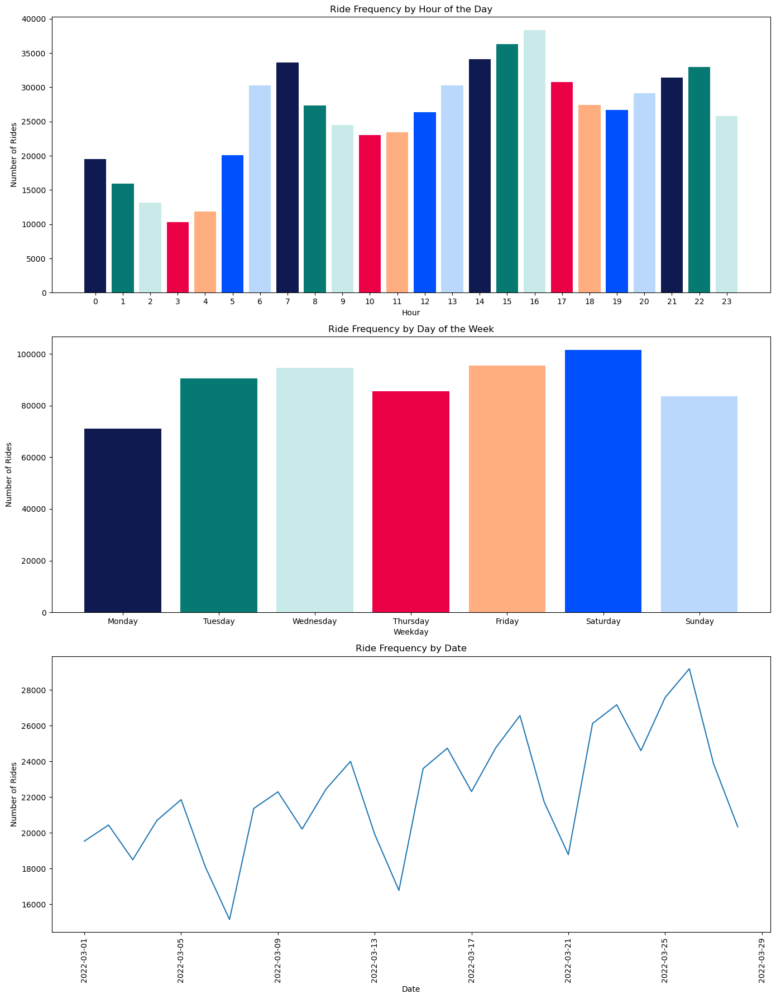

In [20]:
# 1.start_time count for each day and hour
import matplotlib.pyplot as plt

# Create new columns for analysis
data['hour'] = data['start_time'].dt.hour
data['weekday'] = data['start_time'].dt.weekday
data['date'] = data['start_time'].dt.date

# Aggregate data for plotting
hourly_counts = data.groupby('hour').size()
weekday_counts = data.groupby('weekday').size()
daily_counts = data.groupby('date').size()

# Plotting
fig, axes = plt.subplots(3, 1, figsize=(14, 18))

# Hourly ride frequency
axes[0].bar(hourly_counts.index, hourly_counts.values ,color=cpalette)
axes[0].set_title('Ride Frequency by Hour of the Day')
axes[0].set_xlabel('Hour')
axes[0].set_ylabel('Number of Rides')
axes[0].set_xticks(range(24))  

# Weekly ride frequency
axes[1].bar(weekday_counts.index, weekday_counts.values,color=cpalette)
axes[1].set_title('Ride Frequency by Day of the Week')
axes[1].set_xlabel('Weekday')
axes[1].set_ylabel('Number of Rides')
axes[1].set_xticks(range(7))
axes[1].set_xticklabels(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Daily ride frequency
axes[2].plot(daily_counts.index, daily_counts.values)
#axes[2].bar(daily_counts.index, daily_counts.values ,color=cpalette)
axes[2].set_title('Ride Frequency by Date')
axes[2].set_xlabel('Date')
axes[2].set_ylabel('Number of Rides')
axes[2].tick_params(axis='x', rotation=90) 


plt.tight_layout()
plt.show()



* people are riding less on tuesday and thrusday 
* people are riding most around 4pm 
* people are riding less on monday  dipping from saturday 
* overall trend of the month is increasing in the ride counts 

<Figure size 1200x600 with 0 Axes>

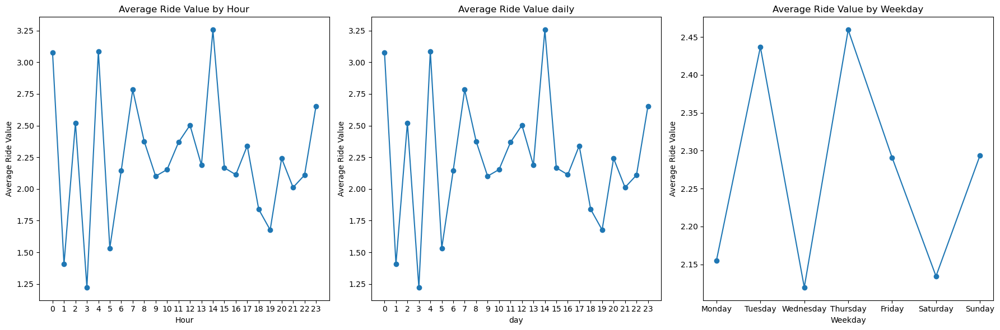

In [21]:

# Group data by hour and calculate average ride value
hourly_ride_value_avg = data.groupby('hour')['ride_value'].mean()

# Group data by weekday and calculate average ride value
weekday_ride_value_avg = data.groupby('date')['ride_value'].mean()


# Group data by weekday and calculate average ride value
weekday_ride_value_avg = data.groupby('weekday')['ride_value'].mean()

# Plotting spatial distribution of start locations to observe any concentration patterns
plt.figure(figsize=(12, 6))

# Plotting average ride value by hour and weekday
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Average ride value by hour
axes[0].plot(hourly_ride_value_avg.index, hourly_ride_value_avg.values, marker='o')
axes[0].set_title('Average Ride Value by Hour')
axes[0].set_xlabel('Hour')
axes[0].set_ylabel('Average Ride Value')
axes[0].set_xticks(range(24))  # Ensure all hours are shown


# Average ride value by daily
axes[1].plot(hourly_ride_value_avg.index, hourly_ride_value_avg.values, marker='o')
axes[1].set_title('Average Ride Value daily')
axes[1].set_xlabel('day')
axes[1].set_ylabel('Average Ride Value')
axes[1].set_xticks(range(24))  # Ensure all hours are shown

# Average ride value by weekday
axes[2].plot(weekday_ride_value_avg.index, weekday_ride_value_avg.values, marker='o')
axes[2].set_title('Average Ride Value by Weekday')
axes[2].set_xlabel('Weekday')
axes[2].set_ylabel('Average Ride Value')
axes[2].set_xticks(range(7))
axes[2].set_xticklabels(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

plt.tight_layout()
plt.show()


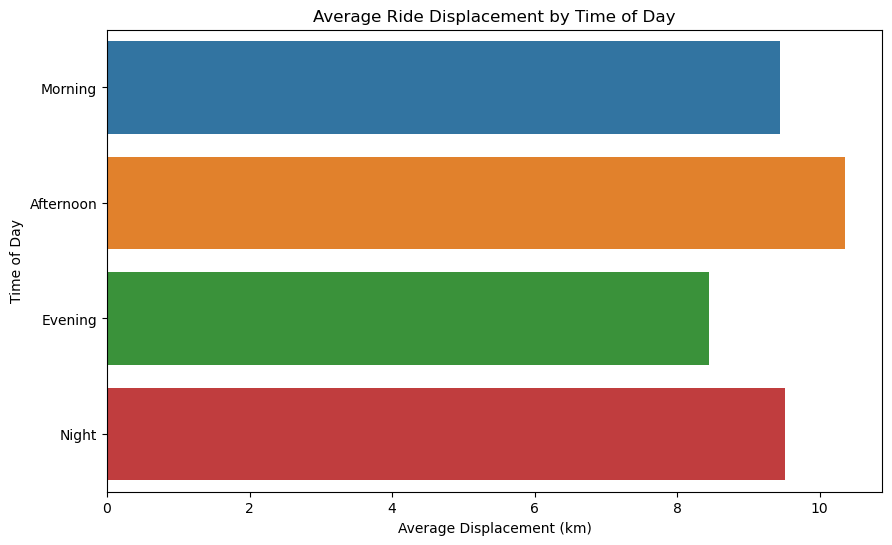

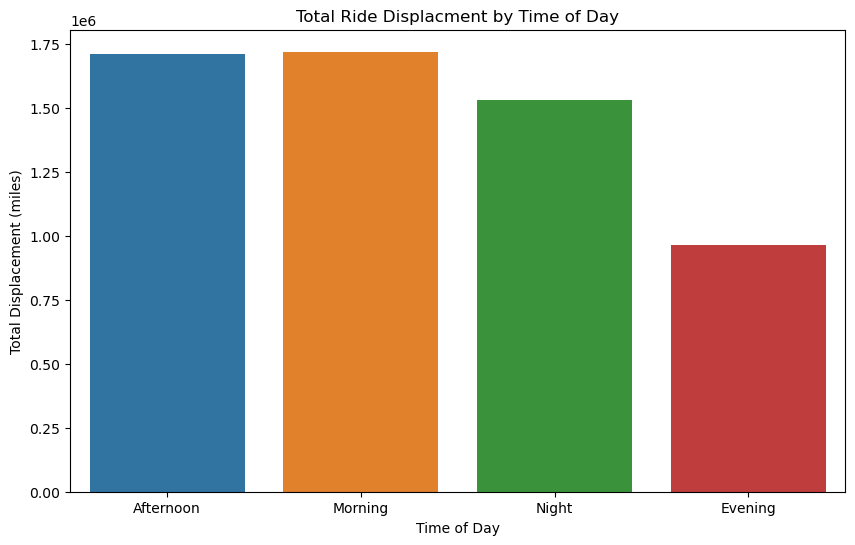

In [22]:

# Adjusting the plot to be horizontal for better visualization
plt.figure(figsize=(10, 6))
sns.barplot(x='displacement_km', y='time_of_day', data=data, estimator=np.mean, errorbar=None, order=['Morning', 'Afternoon', 'Evening', 'Night'], orient='h')
plt.title('Average Ride Displacement by Time of Day')
plt.xlabel('Average Displacement (km)')
plt.ylabel('Time of Day')
plt.show()

plt.figure(figsize=(10, 6))
sns.barplot(x='time_of_day', y='displacement_km', data=data, estimator=sum, errorbar=None)
plt.title('Total Ride Displacment by Time of Day')
plt.xlabel('Time of Day') 
plt.ylabel('Total Displacement (miles)') 
plt.show()


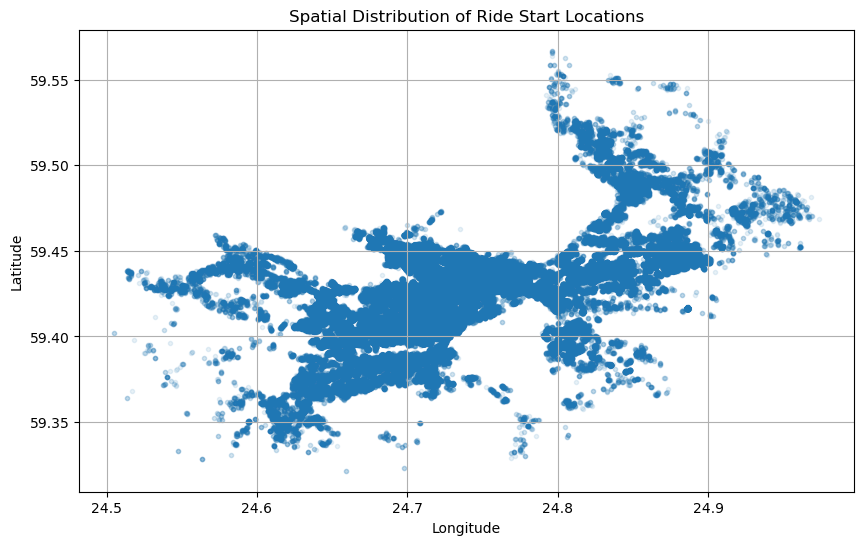

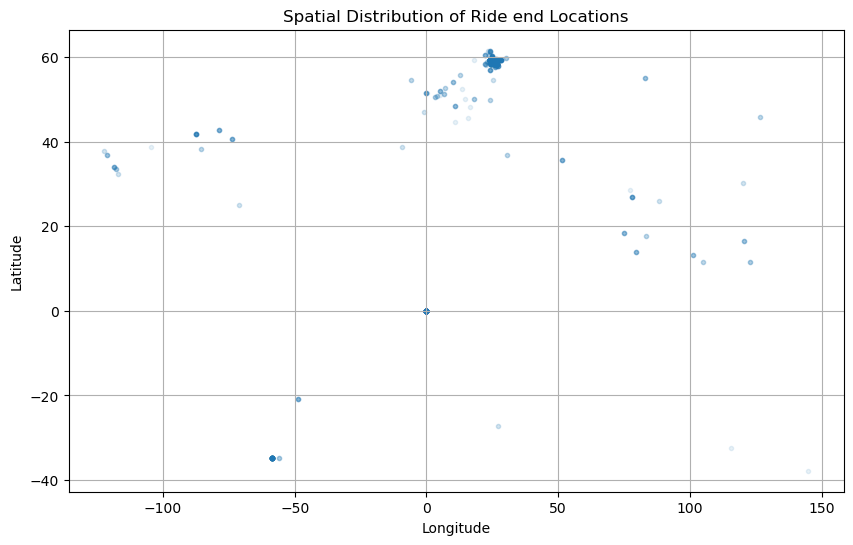

In [23]:
# start end lat lang


# Now, plotting spatial distribution of start points
plt.figure(figsize=(10, 6))
plt.scatter(data['start_lng'], data['start_lat'], alpha=0.1, marker='.')
plt.title('Spatial Distribution of Ride Start Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()



#  plotting spatial distribution of end points
plt.figure(figsize=(10, 6))
plt.scatter(data['end_lng'], data['end_lat'], alpha=0.1, marker='.')
plt.title('Spatial Distribution of Ride end Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

# these is something in the end location

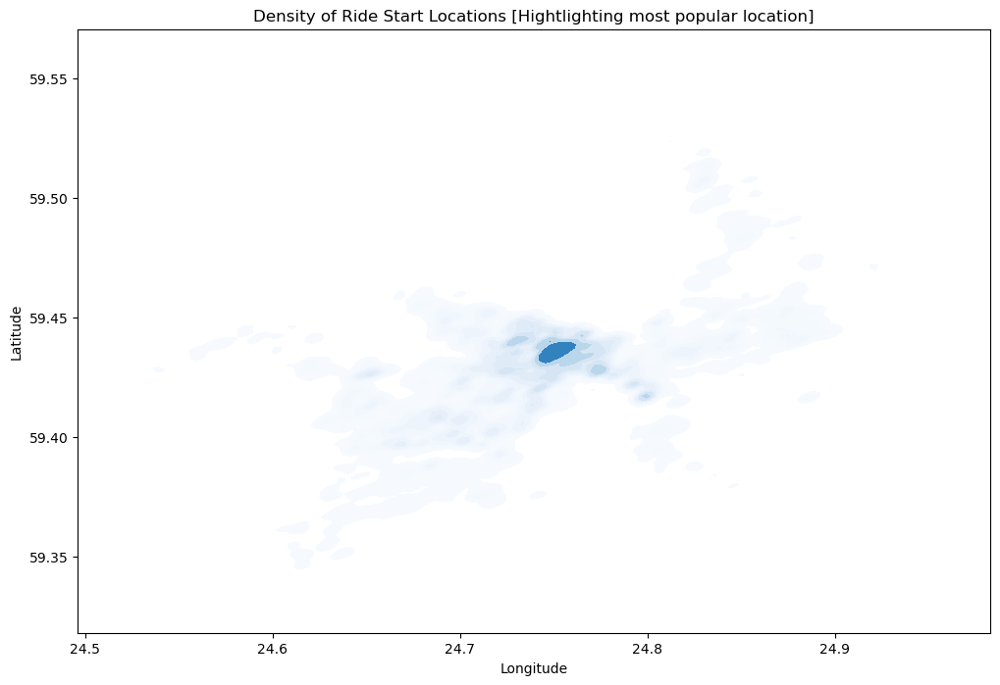

In [24]:


# Assuming 'data' has 'start_lat', 'start_lng', 'end_lat', 'end_lng'

plt.figure(figsize=(12, 8))

# Plotting start locations
sns.kdeplot(x=data['start_lng'], y=data['start_lat'], cmap="Blues", shade=True, bw_adjust=.5)
plt.title('Density of Ride Start Locations [Hightlighting most popular location]')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


while start location is of a fix area , people are travelling in far locations too

# ****************** Part 2 : clustering ************

# clustering analysis based on ride values

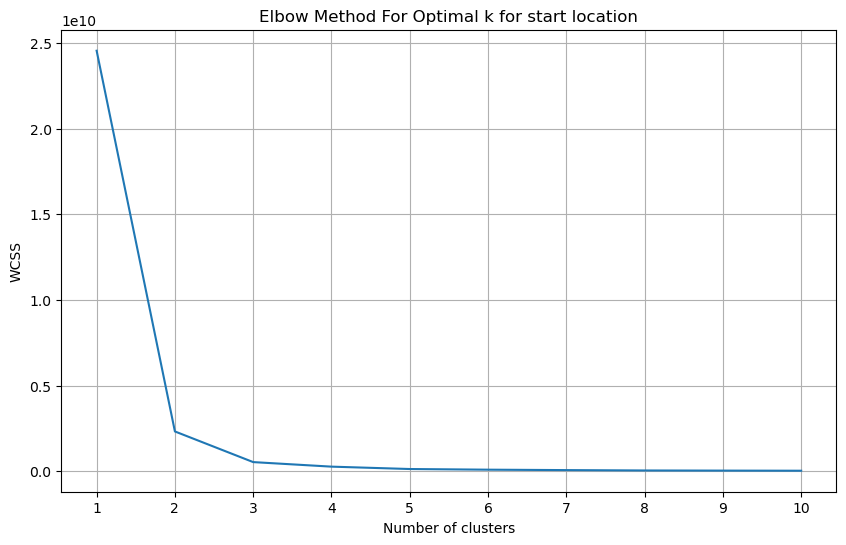

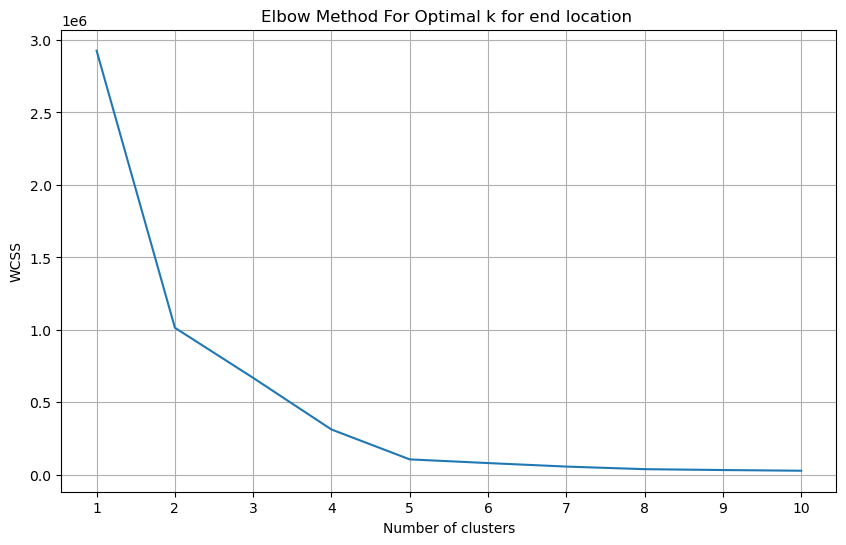

In [25]:


# Selecting only the latitude and longitude for the clustering
X = data[['start_lat', 'start_lng','displacement_km']]

# Using the Elbow Method to determine the optimal number of clusters
wcss = []  # Within-Cluster Sum of Square
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

# Plotting the results onto a line graph to observe the 'elbow'
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method For Optimal k for start location')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')  # Within cluster sum of squares
plt.xticks(range(1, 11))
plt.grid(True)
plt.show()




# Selecting only the latitude and longitude for the clustering
X = data[['end_lat', 'end_lng']]

# Using the Elbow Method to determine the optimal number of clusters
wcss = []  # Within-Cluster Sum of Square
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

# Plotting the results onto a line graph to observe the 'elbow'
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method For Optimal k for end location ')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')  # Within cluster sum of squares
plt.xticks(range(1, 11))
plt.grid(True)
plt.show()





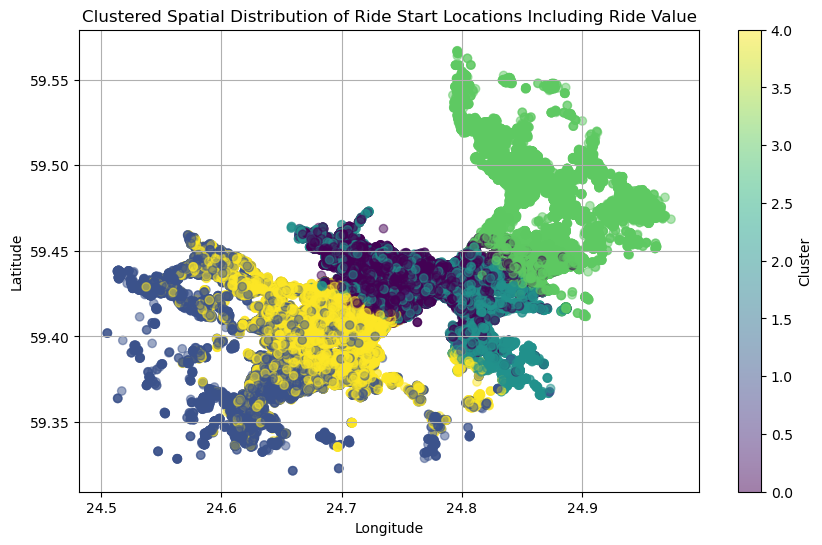

value_cluster
0    0.601816
1    3.032326
2    1.926034
3    2.300221
4    1.156294
Name: ride_value, dtype: float64


In [28]:
data['start_time'] = pd.to_datetime(data['start_time'])
data['hour'] = data['start_time'].dt.hour
data['day'] = data['start_time'].dt.dayofweek  # Monday=0, Sunday=6

# Filter the original data for ride_value < 16
filtered_data = data[data['ride_value'] < 16]

# Prepare your data for clustering
X = filtered_data[['start_lat', 'start_lng', 'ride_value']]

# Standardizing the features to have mean=0 and variance=1
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Determine optimal number of clusters using the Elbow method
# For simplicity, we'll choose a reasonable number of clusters directly
kmeans = KMeans(n_clusters=5, random_state=0).fit(X_scaled)

# Assign cluster labels to the filtered data
filtered_data['value_cluster'] = kmeans.labels_

# Plotting the clusters to visualize high-demand locations based on lat, lng
plt.figure(figsize=(10, 6))
plt.scatter(filtered_data['start_lng'], filtered_data['start_lat'], c=filtered_data['value_cluster'], cmap='viridis', alpha=0.5)
plt.title('Clustered Spatial Distribution of Ride Start Locations Including Ride Value')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Cluster')
plt.grid(True)
plt.show()

# Calculate average ride value by cluster
cluster_ride_value_avg = filtered_data.groupby('value_cluster')['ride_value'].mean()

# Displaying average ride value by cluster
print(cluster_ride_value_avg)

#### on the west side of the city riders are generating less revenue , most are generated by the riders in center

# ************ Part 3 : predictive modelling ***********

In [29]:
from geopy.distance import geodesic

# Defining a function to calculate displacement between start and end coordinates
def calculate_displacement(row):
    start_point = (row['start_lat'], row['start_lng'])
    end_point = (row['end_lat'], row['end_lng'])
    # Calculating the distance using geodesic distance (in kilometers)
    distance = geodesic(start_point, end_point).kilometers
    return distance

# Applying the function to each row in the DataFrame
data['displacement_km'] = data.apply(calculate_displacement, axis=1)
data.head()


from geopy.geocoders import Nominatim
import pandas as pd

# Initialize the geolocator
geolocator = Nominatim(user_agent="geoapiExercises")

def get_district(lat, long):
    try:
        # Perform reverse geocoding to get the location details
        location = geolocator.reverse((lat, long), exactly_one=True, language='en')
        address = location.raw['address']
        
        # Extract the district or relevant location component
        district = address.get('suburb', None) or address.get('city_district', None) or address.get('county', None)
        return district
    except:
        # In case of any error, return None or a default value
        return None

# since above function will require too many api calls we will move to simplier approx solution
def get_district_name(lat, lon):
    # Define bounding boxes for each district
    districts = {
        'Haabersti': ((59.398, 24.635), (59.436, 24.718)),
        'City Centre': ((59.422, 24.713), (59.453, 24.777)),
        'Kristiine': ((59.411, 24.666), (59.437, 24.730)),
        'Lasnamäe': ((59.411, 24.790), (59.470, 24.889)),
        'Mustamäe': ((59.383, 24.641), (59.424, 24.716)),
        'Nõmme': ((59.357, 24.595), (59.403, 24.731)),
        'Pirita': ((59.436, 24.772), (59.501, 24.912)),
        'North Tallinn': ((59.429, 24.665), (59.458, 24.754)),
    }
    
    for district, ((sw_lat, sw_lon), (ne_lat, ne_lon)) in districts.items():
        if sw_lat <= lat <= ne_lat and sw_lon <= lon <= ne_lon:
            return district
    
    return "Unknown"

data['district'] = data.apply(lambda row: get_district_name(row['start_lat'], row['start_lng']), axis=1)
data['End_district'] = data.apply(lambda row: get_district_name(row['end_lat'], row['end_lng']), axis=1)
data.head()


def categorize_time(hour): 
    if 5 <= hour < 12:return 'Morning'
    elif 12 <= hour < 17 : return 'Afternoon'
    elif 17 <= hour < 21: return 'Evening'
    else: return 'Night'




# Extract  date,  hour,  day oy ueeh,  and month  froms tant_time
data['start_time']=pd.to_datetime(data['start_time'])
data['date'] = data['start_time'].dt.date
data['hour'] = data['start_time'].dt.hour
data['day_of_week'] = data['start_time'].dt.dayofweek # Mondoy=0, Sundoy=
data['month'] = data['start_time'].dt.month
data['time_of_day']=data['hour'].apply(categorize_time)


data.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,displacement_km,district,End_district,date,hour,day_of_week,month,time_of_day,weekday,day
0,2022-03-06 15:02:39.329452,59.407910,24.689836,59.513027,24.831630,3.51825,14.205080,Haabersti,Unknown,2022-03-06,15,6,3,Afternoon,6,6
1,2022-03-10 11:15:55.177526,59.441650,24.762712,59.426450,24.783076,0.50750,2.050095,City Centre,Unknown,2022-03-10,11,3,3,Morning,3,3
2,2022-03-06 14:23:33.893257,59.435404,24.749795,59.431901,24.761588,0.19025,0.774715,City Centre,City Centre,2022-03-06,14,6,3,Afternoon,6,6
3,2022-03-03 09:11:59.104192,59.406920,24.659006,59.381093,24.641652,0.75600,3.041401,Haabersti,Nõmme,2022-03-03,9,3,3,Morning,3,3
4,2022-03-06 00:13:01.290346,59.434940,24.753641,59.489203,24.876170,2.27100,9.209442,City Centre,Pirita,2022-03-06,0,6,3,Night,6,6


In [30]:
#solution 0. on full data

# Feature and target selection
features = ['start_lat', 'start_lng', 'hour', 'day_of_week', 'month', 'displacement_km']
categorical_features = ['district', 'End_district', 'time_of_day']
X = data[features + categorical_features]
y = data['ride_value']  # or another column representing demand

# Preprocessing for categorical features
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ],
    remainder='passthrough'
)

# Create a modeling pipeline
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RandomForestRegressor(random_state=42))
])

# Splitting the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model
model.fit(X_train, y_train)

# Predict and evaluate
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

print(f"RMSE: {rmse}")


RMSE: 0.4194022940278707


#  Solution 1: using districts and subdistricts data (for high level grouping)

##### source wikipedia : 

Tallinn is subdivided into eight administrative linnaosa (districts). Each district has a linnaosa valitsus (district government) which is managed by a linnaosavanem (district elder) who is appointed by the city government. The function of the "district governments", however, is not directly governing, but just limited to providing advice to the city government and the city council on issues related to the administration of respective districts.

The districts are administratively further divided into 84 asum (subdistricts or "neighbourhoods" with officially defined borders

### for simplicity we have used district data

In [31]:
# Perform groupby operation to get the count and sum of 'ride_value' based on 'date' and 'hour'
grouped_data = data.groupby(['date', 'hour','district']).agg(count=('ride_value', 'count'), sum=('ride_value', 'sum'))#.reset_index()

# Display the aggregated data
train_set=grouped_data.round().reset_index()
train_set.columns=['date' ,'hour' ,'district' ,'demand' ,'revenue']
train_set['lag_1'] = train_set['demand'].shift(1)
train_set['lag_2'] = train_set['demand'].shift(2)
train_set['lag_3'] = train_set['demand'].shift(3)
train_set['lag_4'] = train_set['demand'].shift(4)
train_set['rolling_mean'] = train_set['demand'].rolling(window=4).mean()
train_set.head()


,date,hour,district,demand,revenue,lag_1,lag_2,lag_3,lag_4,rolling_mean
0,2022-03-01,0,City Centre,382,2031.0,NaN,NaN,NaN,NaN,NaN
1,2022-03-01,0,Haabersti,64,117.0,382.0,NaN,NaN,NaN,NaN
2,2022-03-01,0,Kristiine,4,3.0,64.0,382.0,NaN,NaN,NaN
3,2022-03-01,0,Lasnamäe,33,52.0,4.0,64.0,382.0,NaN,120.75
4,2022-03-01,0,Mustamäe,20,31.0,33.0,4.0,64.0,382.0,30.25


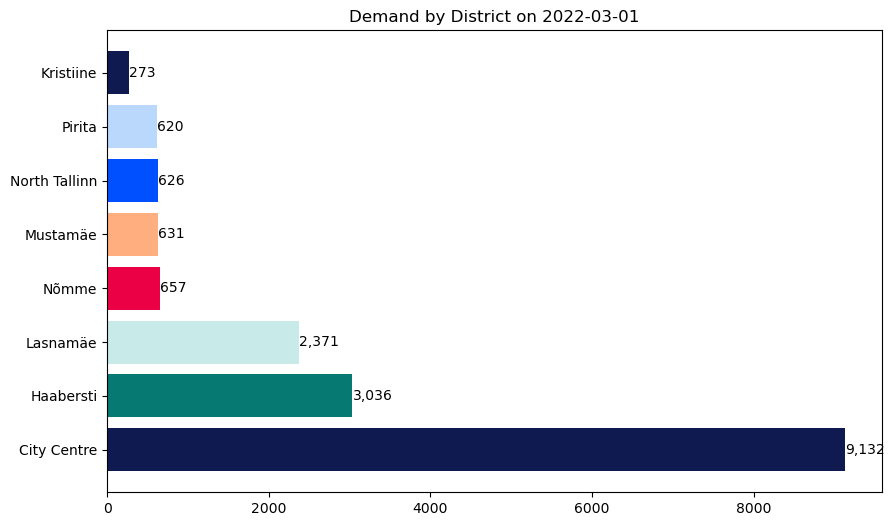

In [32]:
# Convert 'date' to datetime
df=train_set
df['date'] = pd.to_datetime(df['date'])

# Aggregate demand by day and district (assuming your real dataset has more dates)
daily_demand = df.groupby(['date', 'district'], as_index=False)['demand'].sum()
daily_demand=daily_demand[daily_demand['district'] != 'Unknown']
# Assuming 'daily_demand' contains the aggregated data
unique_days = daily_demand['date'].unique()
fig, ax = plt.subplots(figsize=(10, 6))

def draw_barchart(day):
    dff = daily_demand[daily_demand['date'] == day].nlargest(8, 'demand')
    ax.clear()
    ax.barh(dff['district'], dff['demand'],color=cpalette)
    for i, (value, name) in enumerate(zip(dff['demand'], dff['district'])):
        ax.text(value, i, f'{value:,.0f}',  size=10, ha='left', va='center')
    ax.set_yticks(dff['district'])
    ax.set_yticklabels(dff['district'])
    ax.set_title(f'Demand by District on {day.date()}')

ani = animation.FuncAnimation(fig, draw_barchart, frames=unique_days)

# To display the animation in a Jupyter notebook
HTML(ani.to_jshtml())


## time and location demand

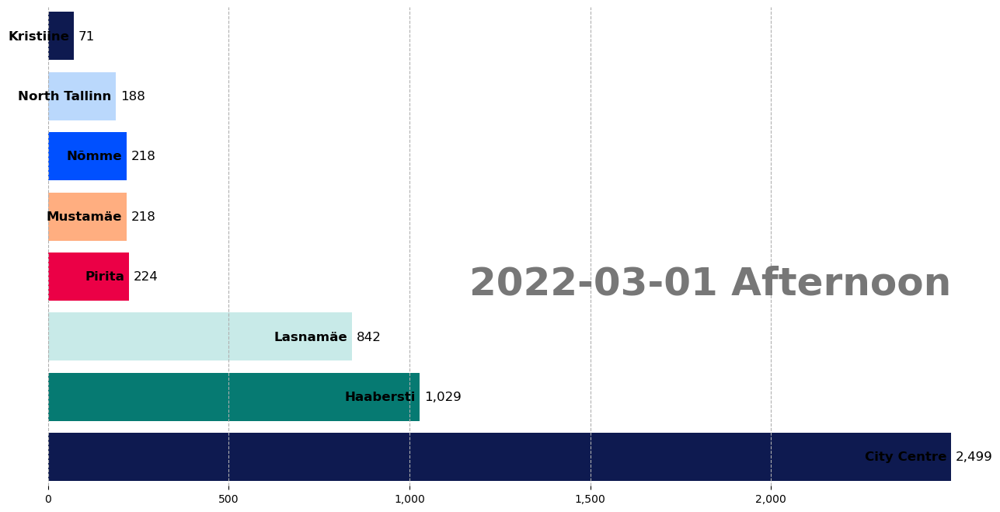

In [33]:
# Define a function to categorize hours
def categorize_hour(hour):
    if 0 <= hour <= 5:
        return 'Early Morning'
    elif 6 <= hour <= 11:
        return 'Morning'
    elif 12 <= hour <= 17:
        return 'Afternoon'
    else:
        return 'Evening'

# Apply the categorization
df['time_of_day'] = df['hour'].apply(categorize_hour)

# Sample data setup continued
# Aggregate demand by date, time_of_day, and district
grouped_demand = df.groupby(['date', 'time_of_day', 'district'], as_index=False)['demand'].sum()
grouped_demand=grouped_demand[grouped_demand['district'] != 'Unknown']
# Prepare the data for animation
unique_times = grouped_demand['date'].astype(str) + ' ' + grouped_demand['time_of_day']
unique_times = unique_times.unique()

fig, ax = plt.subplots(figsize=(15, 8))

def draw_barchart(time):
    # Split the combined date and time_of_day
    date_str, time_of_day = time.split(' ', 1)
    dff = grouped_demand[(grouped_demand['date'].astype(str) == date_str) & (grouped_demand['time_of_day'] == time_of_day)].nlargest(8, 'demand')
    ax.clear()
    ax.barh(dff['district'], dff['demand'],color=cpalette)
    dx = dff['demand'].max() / 200
    for i, (value, name) in enumerate(zip(dff['demand'], dff['district'])):
        ax.text(value-dx, i, name, size=12, weight=600, ha='right', va='center')
        ax.text(value+dx, i, f'{value:,.0f}', size=12, ha='left', va='center')
    
    title_str = f'{date_str} {time_of_day}'
    ax.text(1, 0.4, title_str, transform=ax.transAxes, color='#777777', size=36, ha='right', weight=800)
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:,.0f}'))
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='--')
    plt.box(False)

ani = animation.FuncAnimation(fig, draw_barchart, frames=unique_times, interval=1000)

# Display in Jupyter Notebook
HTML(ani.to_jshtml())


In [34]:

# Load the data (simulated for demonstration)
# In a real scenario, replace this with loading your actual time series data
from statsmodels.tools.eval_measures import rmse
df = train_set

# Splitting the time series into training and testing sets
split_point = int(len(df) * 0.8)
train, test = df['demand'][0:split_point], df['demand'][split_point:]

# Define and fit the ARIMA model
model = ARIMA(train, order=(1,1,1))
model_fit = model.fit()
# Forecast
forecast = model_fit.forecast(steps=len(test))
# Calculate RMSE between the forecast and the actual test set
forecast_rmse = rmse(test, forecast)
print('RMSE Arima',forecast_rmse)


df.fillna(0, inplace=True)

# Encoding categorical variables
encoder = LabelEncoder()
df['district_encoded'] = encoder.fit_transform(df['district'])
# Selecting features and target variable
X = df[['hour', 'district_encoded', 'lag_1', 'lag_2', 'lag_3', 'lag_4', 'rolling_mean']]
y = df['demand']

# Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Training the RandomForestRegressor model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predicting the demand on the test set
y_pred = model.predict(X_test)

# Evaluating the model
mse = mean_squared_error(y_test, y_pred)
rmse = mse ** 0.5

print(f"RMSE random forest: {rmse}")


# XGBoost Regressor
xgb_model = xgb.XGBRegressor(objective ='reg:squarederror', n_estimators=100, seed=42)
xgb_model.fit(X_train, y_train)
y_pred_xgb = xgb_model.predict(X_test)
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
rmse_xgb = mse_xgb ** 0.5
print(f"RMSE XGBoost : {rmse_xgb}")

# Linear Regression
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
y_pred_linear = linear_model.predict(X_test)
mse_linear = mean_squared_error(y_test, y_pred_linear)
rmse_linear = mse_linear ** 0.5
print(f"RMSE Linear Regression : {rmse_linear}")

# Initialize models
lasso_model = Lasso(alpha=0.1)
ridge_model = Ridge(alpha=0.1)

# Fit models
lasso_model.fit(X_train, y_train)
ridge_model.fit(X_train, y_train)

# Predict on test set
y_pred_lasso = lasso_model.predict(X_test)
y_pred_ridge = ridge_model.predict(X_test)

# Calculate RMSE
rmse_lasso = mean_squared_error(y_test, y_pred_lasso, squared=False)
rmse_ridge = mean_squared_error(y_test, y_pred_ridge, squared=False)
print("RMSE ridge :", rmse_ridge)
print ("RMSE lasso :",rmse_lasso)



RMSE Arima 157.1660031779213
RMSE random forest: 11.973084380675552
RMSE XGBoost : 10.763065441321467
RMSE Linear Regression : 1.5206288556658722
RMSE ridge : 1.520625843157115
RMSE lasso : 1.4796553609734377


In [35]:
from joblib import dump, load
best_model=rmse_lasso
# Save the model to a file
model_filename = 'rmse_lasso.joblib'
dump(best_model, model_filename)

print(f"Model saved to {model_filename}")


Model saved to rmse_lasso.joblib


In [36]:
## For ARIMA models or others not directly compatible with joblib, 
## we will use alternative serialization methods like pickleTo save your model as a pickle file, you can use Python's built-in `pickle` module. This method is suitable for a wide variety of models, including those from scikit-learn, xgboost, and even custom Python objects. Here's how you can save and load your model using `pickle`:

### Saving the Model with Pickle

import pickle

# Save the model to a file
model_filename = 'best_model.pkl'

with open(model_filename, 'wb') as file:  
    pickle.dump(best_model, file)

print(f"Model saved to {model_filename}")


# Load the model from the file
with open(model_filename, 'rb') as file:  
    loaded_model = pickle.load(file)


Model saved to best_model.pkl


# Solution 2 : if we cant use district and subdistrict data we will use 
# Density based clustering : DBSCAN (for deep level grouping)
using location , hour and day of week

##### Reduce the precision of latitude and longitude
3 : 100m 

2 : 1.1km

[  -1    0    1 ... 5014 5015 5016]
Silhouette Score: 0.9999997833875018
points not clustered (538129, 9)
points clustered (89081, 9)


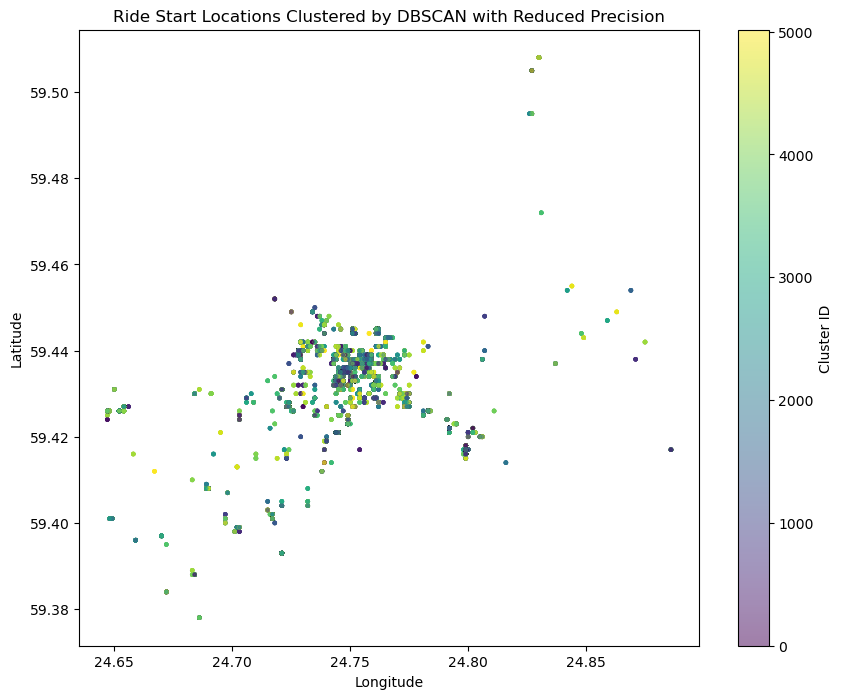

In [42]:
import pandas as pd
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Load the dataset
data = pd.read_csv('data.csv')
data['start_time'] = pd.to_datetime(data['start_time'])
data['hour'] = data['start_time'].dt.hour
data['day'] = data['start_time'].dt.dayofweek  # Monday=0, Sunday=6

# Reduce the precision of latitude and longitude
data['start_lat'] = data['start_lat'].round(3)  # Adjust the number of decimal places as needed
data['start_lng'] = data['start_lng'].round(3)

# Prepare your data for spatial clustering
coords = data[['start_lat', 'start_lng', 'hour', 'day']]
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(coords)

# Apply DBSCAN for spatial clustering
db = DBSCAN(eps=0.001, min_samples=10).fit(coords_scaled)  # Adjust eps and min_samples as needed
data['cluster'] = db.labels_
print(data['cluster'].unique())

# Evaluate Clusters with Silhouette Score (excluding noise points)
filtered_labels = data[data['cluster'] != -1]['cluster']
filtered_coords = coords_scaled[data['cluster'] != -1]

if len(np.unique(filtered_labels)) > 1:  # Need at least 2 clusters excluding noise to calculate
    silhouette_avg = silhouette_score(filtered_coords, filtered_labels)
    print(f"Silhouette Score: {silhouette_avg}")
else:
    print("Silhouette score cannot be calculated for a single cluster or only noise points.")

print ('points not clustered',data[data['cluster'] == -1].shape)
print ('points clustered',data[data['cluster'] != -1].shape)
# Filter out noise points before plotting
data=data[data['cluster'] != -1]

# Plot the clusters
plt.figure(figsize=(10, 8))
plt.scatter(data['start_lng'], data['start_lat'], c=data['cluster'], cmap='viridis', s=5, alpha=0.5)
plt.colorbar(label='Cluster ID')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Ride Start Locations Clustered by DBSCAN with Reduced Precision')
plt.show()


# reducing complexity so that more points can be in cluster

In [7]:
import pandas as pd
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Load the dataset
data = pd.read_csv('data.csv')
data['start_time'] = pd.to_datetime(data['start_time'])
data['hour'] = data['start_time'].dt.hour
data['day'] = data['start_time'].dt.dayofweek  # Monday=0, Sunday=6

# Reduce the precision of latitude and longitude
data['start_lat'] = data['start_lat'].round(2)  # Adjust the number of decimal places as needed
data['start_lng'] = data['start_lng'].round(2)

# Prepare your data for spatial clustering
coords = data[['start_lat', 'start_lng', 'day']]
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(coords)

# Apply DBSCAN for spatial clustering
db = DBSCAN(eps=0.001, min_samples=40).fit(coords_scaled)  # Adjust eps and min_samples as needed
data['cluster'] = db.labels_
print(data['cluster'].unique())

print ('points not clustered',data[data['cluster'] == -1].shape)
print ('points clustered',data[data['cluster'] != -1].shape)



[   0    1    2 ... 1290 1291 1292]
points not clustered (18286, 9)
points clustered (608924, 9)


In [ ]:


# Evaluate Clusters with Silhouette Score (excluding noise points)
filtered_labels = data[data['cluster'] != -1]['cluster']
filtered_coords = coords_scaled[data['cluster'] != -1]

if len(np.unique(filtered_labels)) > 1:  # Need at least 2 clusters excluding noise to calculate
    silhouette_avg = silhouette_score(filtered_coords, filtered_labels)
    print(f"Silhouette Score: {silhouette_avg}")
else:
    print("Silhouette score cannot be calculated for a single cluster or only noise points.")




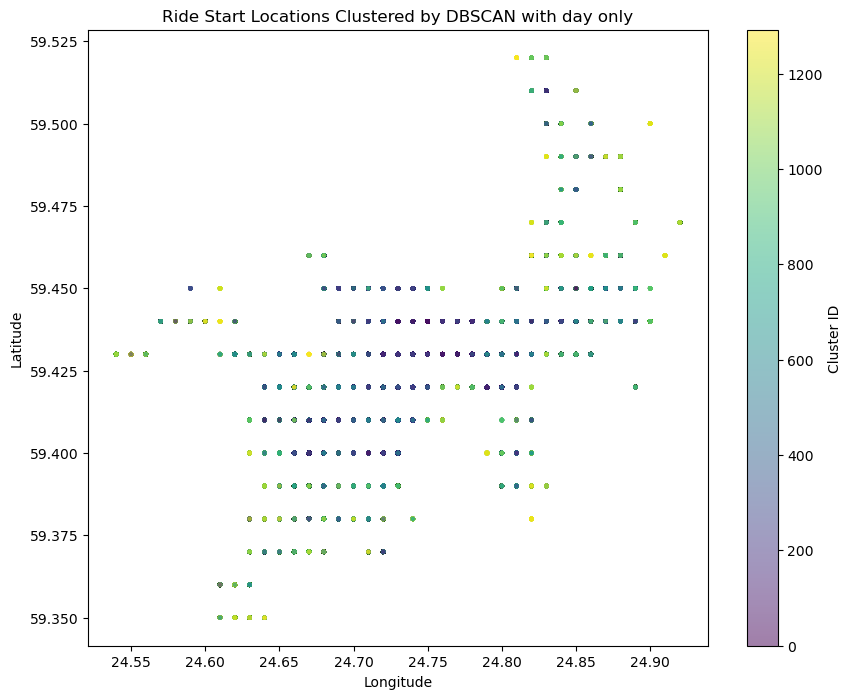

In [9]:

# Filter out noise points before plotting

data=data[data['cluster'] != -1]

# Plot the clusters
plt.figure(figsize=(10, 8))
plt.scatter(data['start_lng'], data['start_lat'], c=data['cluster'], cmap='viridis', s=5, alpha=0.5)
plt.colorbar(label='Cluster ID')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Ride Start Locations Clustered by DBSCAN with day only')
plt.show()



In [ ]:
# Count the occurrences of each cluster label, excluding noise points (-1)
cluster_sizes = data[data['cluster'] != -1]['cluster'].value_counts().sort_values(ascending=False)

# Display the sizes of the top 10 clusters
top_10_cluster_sizes = cluster_sizes.head(10)
print("Sizes of the Top 10 Clusters:")
print(top_10_cluster_sizes)


In [38]:
# only for day
data['start_time'] = pd.to_datetime(data['start_time'])
data['hour'] = data['start_time'].dt.hour
data['day'] = data['start_time'].dt.dayofweek  # Monday=0, Sunday=6

# Encode 'cluster' as a categorical feature
encoder = LabelEncoder()
data['cluster_encoded'] = encoder.fit_transform(data['cluster'])

# Create a more realistic target variable - count of ride requests by hour and cluster
grouped_data = data.groupby(['hour', 'day', 'cluster_encoded']).size().reset_index(name='ride_count')
X = grouped_data[['hour', 'day', 'cluster_encoded']]
y = grouped_data['ride_count']

# Split the dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the RandomForestRegressor
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predict on the test set
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
print(f"RMSE: {rmse}")

# Save the model to disk
model_filename = 'scooter_demand_model.pkl'
joblib.dump(model, model_filename)
print(f"Model saved to {model_filename}")


RMSE: 13.259331891681349
Model saved to scooter_demand_model.pkl


 #### kernal was getting dead and Hdbscan also not worked so we have to reduce eps value

In [12]:
#!pip install folium

# Preprocess and feature engineering
data['start_time'] = pd.to_datetime(data['start_time'])
data['hour'] = data['start_time'].dt.hour
hourly_groups = data.groupby('hour')[['start_lat', 'start_lng']].apply(lambda g: g.values.tolist()).tolist()

data['day'] = data['start_time'].dt.dayofweek  # Monday=0, Sunday=6
avg_lat = data['start_lat'].mean()
avg_lng = data['start_lng'].mean()

#### using folium to check more on density analysis

In [13]:

# Prepare data for HeatMapWithTime
# Create a base map
map_with_time = folium.Map(location=[avg_lat, avg_lng], zoom_start=12)
# Add the temporal heatmap layer
HeatMapWithTime(hourly_groups, auto_play=True, max_opacity=0.8).add_to(map_with_time)
# Display the map
map_with_time


In [ ]:

# Prepare spatial data
coords = data[['start_lat', 'start_lng']].values

# DBSCAN clustering
db = DBSCAN(eps=0.001, min_samples=40).fit(coords)  # eps and min_samples chosen for example; adjust based on your data
cluster_labels = db.labels_

# Filter out noise (-1 labels)
filtered_coords = coords[cluster_labels != -1]
filtered_labels = cluster_labels[cluster_labels != -1]

# Plot clusters on map
cluster_map = folium.Map(location=[avg_lat, avg_lng], zoom_start=12)
for label, location in zip(filtered_labels, filtered_coords):
    folium.CircleMarker(location=[location[0], location[1]],
                        radius=5,
                        color='red',
                        fill=True).add_to(cluster_map)

cluster_map


using geopandas and folium to create dbscan clusters using geometric cordinated 

In [ ]:


# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.start_lng, data.start_lat))

# Set the coordinate reference system (CRS) to WGS84 (EPSG:4326)
gdf.crs = "EPSG:4326"


# Extract coordinates for DBSCAN
coords = np.array(gdf.geometry.apply(lambda geom: (geom.y, geom.x)).tolist())

# Apply DBSCAN
db = DBSCAN(eps=0.01, min_samples=25, algorithm='ball_tree', metric='haversine').fit(np.radians(coords))
gdf['cluster'] = db.labels_

# Filter out noise
gdf_clustered = gdf[gdf['cluster'] != -1]

# Visualize clusters
fig, ax = plt.subplots(figsize=(10, 10))
gdf.plot(ax=ax, color='lightgrey', markersize=2)
gdf_clustered.plot(column='cluster', ax=ax, categorical=True, legend=True, markersize=10,
                   cmap='viridis')
plt.title("Clusters of High-Demand Locations")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()


# Create a base map
m = folium.Map(location=[gdf.geometry.y.mean(), gdf.geometry.x.mean()], zoom_start=12)

# Add clustered points to the map
for _, row in gdf_clustered.iterrows():
    folium.CircleMarker(location=[row.geometry.y, row.geometry.x],
                        radius=3,
                        popup=f'Cluster: {row.cluster}',
                        color='blue',
                        fill=True).add_to(m)

m


* Explore the data and suggest a solution to guide the drivers towards areas with higher expected demand at given time and location

Solution are generated based on either density of the riders or district location of the driver


* Build and document a baseline model for your solution

models have been developed using RMSE metrics 
#### all models use time(day of week/date , hour ) , location  

* Describe how you would design and deploy such a model

models are downloaded as pkl and joblib file , now we can deploy it to any cloud service like aws 

* Describe how to communicate model recommendations to drivers

When it comes to guiding drivers towards areas with higher demand, we've got you covered! Here's how we make it easy for drivers to know exactly where to go:
First off, we  integrate our recommendations right into the driver's app. So, whenever they open it up,  They've got all the info they need right there on the dashboard.
 We use maps and lists to show them the best places to be, all color-coded and marked so they can spot them in a snap.

* Think through and describe the design of the experiment  that would validate your solution for live operations taking into account marketplace specifics
We would start by dividing our driver pool into two groups: a control group and an experimental group. The control group would continue operating as usual, while the experimental group would receive our model recommendations through the app to do AB testing.

To evaluate the effectiveness of our recommendations, we would define key metrics such as average rider wait time, driver earnings, and overall platform efficiency.
Throughout the experiment, we would collect real-time data on driver activities, ride requests, and system performance. This data would allow us to assess how our recommendations impact various aspects of the marketplace.

The experiment would run over a defined period, taking into account seasonal variations and market dynamics. This duration would provide us with insights into long-term trends and patterns.
Once the experiment is complete, we would analyze the data to compare the performance of the control and experimental groups. Statistical tests would help us determine if any observed differences are statistically significant.

Additionally, we would gather feedback from drivers and users to understand their experiences with the recommendations. This feedback would be crucial for iterating on our solution and making improvements for future iterations.
By following this experiment design, we can confidently validate the effectiveness of our solution for live operations, ensuring that it meets the specific needs and challenges of the marketplace.